In [175]:
import os, glob, re, pickle
from functools import partial
from collections import OrderedDict
import operator as op
from cytoolz import compose

import pandas as pd
import seaborn as sns
import numpy as np
import scanpy as sc
import anndata as ad
import matplotlib as mpl
import matplotlib.pyplot as plt

from pyscenic.export import export2loom, add_scenic_metadata
from pyscenic.utils import load_motifs
from pyscenic.transform import df2regulons
from pyscenic.aucell import aucell
from pyscenic.binarization import binarize
from pyscenic.rss import regulon_specificity_scores
from pyscenic.plotting import plot_binarization, plot_rss

from IPython.display import HTML, display

In [2]:
def saveWithPickle(obj, PATH_out, filename="saveWithPickle"):
    import pickle
    with open(f'{PATH_out}/{filename}.pickle', 'wb') as handle:
        pickle.dump(obj, handle, protocol=pickle.HIGHEST_PROTOCOL)

def loadFromPickle(dir_pickle):
    import pickle
    with open(dir_pickle, 'rb') as handle:
        unserialized_pickle = pickle.load(handle)
    return unserialized_pickle

In [3]:
RESOURCES_FOLDERNAME = "/Users/bramvandesande/Projects/lcb/protocol/resources/"
AUXILLIARIES_FOLDERNAME = "/node200data/18parkky/datasets/reference/z_program_references/pyscenic/homo_sapiens/"
RESULTS_FOLDERNAME = "/Users/bramvandesande/Projects/lcb/protocol/results/"

BASE_URL = "http://motifcollections.aertslab.org/v9/logos/"
COLUMN_NAME_LOGO = "MotifLogo"
COLUMN_NAME_MOTIF_ID = "MotifID"
COLUMN_NAME_TARGETS = "TargetGenes"

def savesvg(fname: str, fig, folder) -> None:
    """
    Save figure as vector-based SVG image format.
    """
    fig.tight_layout()
    fig.savefig(os.path.join(folder, fname), format='svg')
    
def display_logos(df: pd.DataFrame, top_target_genes: int = 3, base_url: str = BASE_URL):
    """
    :param df:
    :param base_url:
    """
    # Make sure the original dataframe is not altered.
    df = df.copy()
    
    # Add column with URLs to sequence logo.
    def create_url(motif_id):
        return '<img src="{}{}.png" style="max-height:124px;"></img>'.format(base_url, motif_id)
    df[("Enrichment", COLUMN_NAME_LOGO)] = list(map(create_url, df.index.get_level_values(COLUMN_NAME_MOTIF_ID)))
    
    # Truncate TargetGenes.
    def truncate(col_val):
        return sorted(col_val, key=op.itemgetter(1))[:top_target_genes]
    df[("Enrichment", COLUMN_NAME_TARGETS)] = list(map(truncate, df[("Enrichment", COLUMN_NAME_TARGETS)]))
    
    MAX_COL_WIDTH = pd.get_option('display.max_colwidth')
    pd.set_option('display.max_colwidth', -1)
    display(HTML(df.head().to_html(escape=False)))
    pd.set_option('display.max_colwidth', MAX_COL_WIDTH)

## Load adata

In [4]:
dict_PatientID_to_MSI_class = {'CRC2783': 'MSI-I',
 'CRC2817': 'MSI-L',
 'SC035': 'MSI-I',
 'SC044': 'MSI-H',
 'P04': 'MSI-H',
 'P15': 'MSI-I',
 'P17': 'MSI-L',
 'P18': 'MSI-L',
 'P19': 'MSI-I',
 'P20': 'MSI-I',
 'P21': 'MSI-H',
 'P22': 'MSI-I',
 'P23': 'MSI-H',
 'P26': 'MSI-I'}

In [5]:
Smillie_marker      = pd.read_csv('/node200data/18parkky/datasets/reference/marker_genes/colon/Smillie_et_al/colon_epithelial_marker.csv')
CellCycle_marker    = pd.read_csv('/node200data/18parkky/datasets/reference/marker_genes/cell_cycle/cell_cycle_marker.tsv', sep='\t')
G2M_markers = list(CellCycle_marker[(CellCycle_marker['phase']=='G2/M')]['gene_symbol'])
S_markers   = list(CellCycle_marker[(CellCycle_marker['phase']=='S')]['gene_symbol'])

In [6]:
adata_joanito = sc.read_h5ad('/node200data/18parkky/datasets/data/public/processed_data/Joanito_et_al/2_cell_type_labeled_h5ad/Joanito.MSI.preprocessed.NanoMnT.ManualAnnot.labeled.h5ad')
adata_chen = sc.read_h5ad('/node200data/18parkky/datasets/data/public/processed_data/Immunotherapy_CRC_Chen_et_al/2_cell_type_labeled_h5ad/Chen.MSI.preprocessed.NanoMnT.ManualAnnot.labeled.h5ad')

In [7]:
chen_patient_metadata = pd.read_csv('/node200data/18parkky/datasets/data/public/FASTQ/Immunotherapy_CRC_Chen_et_al/metadata/Chen_et_al.patient_meta.csv',)

dict_PatientID_to_TumorStage = { list(tup)[1] : list(tup)[7] for tup in chen_patient_metadata.itertuples() }
dict_PatientID_to_TumorRegressionRatio = { list(tup)[1] : list(tup)[12] for tup in chen_patient_metadata.itertuples() }
dict_PatientID_to_Age = { list(tup)[1] : list(tup)[2] for tup in chen_patient_metadata.itertuples() }

adata_chen.obs['TumorStage'] = [ dict_PatientID_to_TumorStage[PID] for PID in adata_chen.obs['PatientID'] ]
adata_chen.obs['TumorRegressionRatio'] = [ dict_PatientID_to_TumorRegressionRatio[PID] for PID in adata_chen.obs['PatientID'] ]
adata_chen.obs['Age'] = [ dict_PatientID_to_Age[PID] for PID in adata_chen.obs['PatientID'] ]

chen_patient_order_by_MSI_intensity     = ['P18', 'P17', 'P15', 'P26', 'P20', 'P19', 'P22', 'P23', 'P21', 'P04']
chen_patient_order_by_MSI_intensity_P18 = ['P17', 'P15', 'P26', 'P20', 'P19', 'P22', 'P23', 'P21', 'P04']

chen_patient_order_by_MSI_intensity_AC  = ['P26', 'P20', 'P21', 'P04']
chen_patient_order_by_MSI_intensity_TC  = ['P19', 'P22', 'P23',]
chen_patient_order_by_MSI_intensity_SC  = ['P18', 'P17', 'P15']

joanito_patient_order_by_MSI_intensity  = ['CRC2817', 'SC035', 'CRC2783', 'SC044']

## Prepare pySCENIC auxillary datasets

In [8]:
# Downloaded fromm pySCENIC github repo: https://github.com/aertslab/pySCENIC/tree/master/resources
HUMAN_TFS_FNAME = os.path.join(AUXILLIARIES_FOLDERNAME, 'lambert2018.txt')
# Ranking databases. Downloaded from cisTargetDB: https://resources.aertslab.org/cistarget/
RANKING_DBS_FNAMES = list(map(lambda fn: os.path.join(AUXILLIARIES_FOLDERNAME, fn),
                       ['hg38_500bp_up_100bp_down_full_tx_v10_clust.genes_vs_motifs.rankings.feather',
                       'hg38_10kbp_up_10kbp_down_full_tx_v10_clust.genes_vs_motifs.rankings.feather']))
# Motif annotations. Downloaded from cisTargetDB: https://resources.aertslab.org/cistarget/
MOTIF_ANNOTATIONS_FNAME = os.path.join(AUXILLIARIES_FOLDERNAME, 'motifs-v10nr_clust-nr.hgnc-m0.001-o0.0.tbl')

## pySCENIC pipeline (Joanito et al)

In [ ]:
# https://htmlpreview.github.io/?https://github.com/aertslab/SCENICprotocol/blob/master/notebooks/PBMC10k_SCENIC-protocol-CLI.html

In [9]:
import os
import numpy as np
import pandas as pd
import scanpy as sc
import loompy as lp

from MulticoreTSNE import MulticoreTSNE as TSNE
import json
import base64
import zlib
from pyscenic.plotting import plot_binarization
from pyscenic.export import add_scenic_metadata
from pyscenic.cli.utils import load_signatures
import matplotlib as mpl
import matplotlib.pyplot as plt
# from scanpy.plotting._tools.scatterplots import plot_scatter
import seaborn as sns

### Set directories and load files

In [11]:
# set variables for file paths to read from and write to:

# set a working directory
wdir = "/node200data/18parkky/datasets/data/public/processed_data/Joanito_et_al/3_GeneExpressionAnalysis/SCENIC"
os.chdir( wdir )

# path to unfiltered loom file (this will be created in the optional steps below)
f_loom_path_unfilt = "Joanito_tumor_epi_unfiltered.loom" # test dataset, n=500 cells

# # path to loom file with basic filtering applied (this will be created in the "initial filtering" step below). Optional.
f_loom_path_scenic = "Joanito_tumor_epi_filtered_scenic.loom"

# path to anndata object, which will be updated to store Scanpy results as they are generated below
f_anndata_path = "anndata.h5ad"

# path to pyscenic output
f_pyscenic_output = "pyscenic_output.loom"

# loom output, generated from a combination of Scanpy and pySCENIC results:
f_final_loom = 'Joanito_tumor_epi_scenic_integrated-output.loom'

In [12]:
sc.settings.verbosity = 3 # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.set_figure_params(dpi=150, fontsize=10, dpi_save=600)
sc.settings.njobs = 36

In [13]:
adata_joanito = adata_joanito.raw.to_adata()

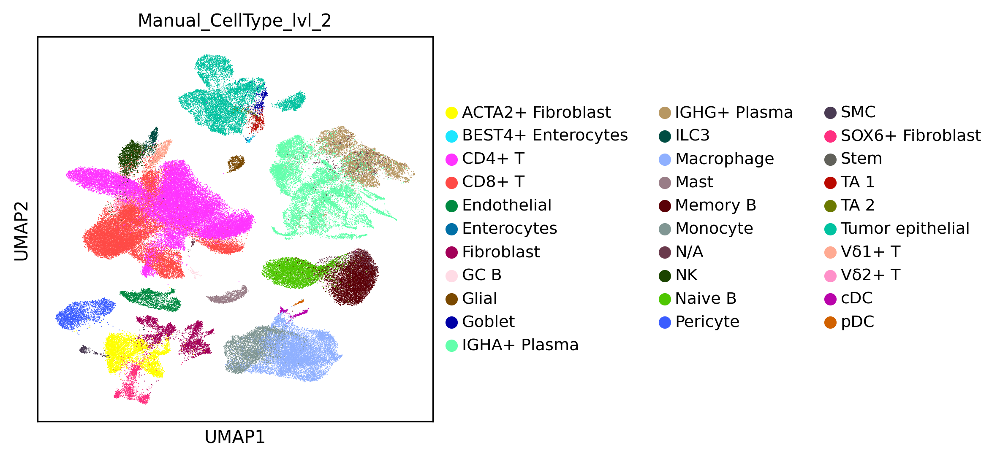

In [43]:
sc.pl.umap(adata_joanito, color=['Manual_CellType_lvl_2'])

### Step 1: Gene regulatory network inference, and generation of co-expression modules

In [14]:
adata_joanito_tumor = adata_joanito[(adata_joanito.obs['Manual_CellType_lvl_1']=='Tumor epithelial') & 
                                    (adata_joanito.obs['MSI']=='MSI-H')]

In [208]:
# create basic row and column attributes for the loom file:
row_attrs = {
    "Gene": np.array(adata_joanito_tumor.var_names) ,
}
col_attrs = {
    "CellID": np.array(adata_joanito_tumor.obs_names) ,
    "nGene": np.array( np.sum(adata_joanito_tumor.X.transpose()>0 , axis=0)).flatten() ,
    "nUMI": np.array( np.sum(adata_joanito_tumor.X.transpose() , axis=0)).flatten() ,
}
lp.create( f_loom_path_scenic, adata_joanito_tumor.X.transpose(), row_attrs, col_attrs)

In [162]:
f_tfs = "/node200data/18parkky/datasets/reference/z_program_references/pyscenic/homo_sapiens/allTFs_hg38.txt" # human
!pyscenic grn {f_loom_path_scenic} {f_tfs} -o adj.csv --num_workers 36


2025-02-20 21:00:22,060 - pyscenic.cli.pyscenic - INFO - Loading expression matrix.

2025-02-20 21:00:23,307 - pyscenic.cli.pyscenic - INFO - Inferring regulatory networks.
/home/18parkky/anaconda3-2021.11/envs/pyscenic/lib/python3.10/site-packages/distributed/node.py:182: UserWarning: Port 8787 is already in use.
Perhaps you already have a cluster running?
Hosting the HTTP server on port 44344 instead
  warnings.warn(
preparing dask client
parsing input
creating dask graph
36 partitions
computing dask graph
/home/18parkky/anaconda3-2021.11/envs/pyscenic/lib/python3.10/site-packages/distributed/client.py:3169: UserWarning: Sending large graph of size 373.01 MiB.
This may cause some slowdown.
Consider scattering data ahead of time and using futures.
  warnings.warn(
not shutting down client, client was created externally
finished
2025-02-20 21:13:00,558 - distributed.worker - ERROR - Failed to communicate with scheduler during heartbeat.
Traceback (most recent call last):
  File "/home

In [209]:
adjacencies = pd.read_csv(f"adj.csv", index_col=False, sep=',')

In [210]:
adjacencies.head()

,TF,target,importance
0,RPL35,RPL31,16.885876
1,RPL6,RACK1,14.820003
2,RPL35,COX7C,14.381112
3,RPL35,RPS2,14.158770
4,RPS4X,RPL14,14.005250


### Step 2-3. Regulon prediction aka cisTarget from CLI

In [211]:
# ranking databases
f_db_glob = "/node200data/18parkky/datasets/reference/z_program_references/pyscenic/homo_sapiens/*feather"
f_db_names = ' '.join( glob.glob(f_db_glob) )

# motif databases
f_motif_path = "/node200data/18parkky/datasets/reference/z_program_references/pyscenic/homo_sapiens/motifs-v10nr_clust-nr.hgnc-m0.001-o0.0.tbl"

In [166]:
!pyscenic ctx adj.csv \
    {f_db_names} \
    --annotations_fname {f_motif_path} \
    --expression_mtx_fname {f_loom_path_scenic} \
    --output reg.csv \
    --num_workers 36
    # --mask_dropouts \


2025-02-20 21:13:12,590 - pyscenic.cli.pyscenic - INFO - Creating modules.

2025-02-20 21:13:13,523 - pyscenic.cli.pyscenic - INFO - Loading expression matrix.

2025-02-20 21:13:16,164 - pyscenic.utils - INFO - Calculating Pearson correlations.

2025-02-20 21:13:16,633 - pyscenic.utils - WARNING - Note on correlation calculation: the default behaviour for calculating the correlations has changed after pySCENIC verion 0.9.16. Previously, the default was to calculate the correlation between a TF and target gene using only cells with non-zero expression values (mask_dropouts=True). The current default is now to use all cells to match the behavior of the R verision of SCENIC. The original settings can be retained by setting 'rho_mask_dropouts=True' in the modules_from_adjacencies function, or '--mask_dropouts' from the CLI.
	Dropout masking is currently set to [False].

2025-02-20 21:14:08,503 - pyscenic.utils - INFO - Creating modules.

2025-02-20 21:15:26,387 - pyscenic.cli.pyscenic - I

### Step 4. Cellular enrichment (aka AUCell) from CLI

In [212]:
nGenesDetectedPerCell = np.sum(adata_joanito_tumor.X>0, axis=1)
percentiles = np.quantile(np.array(nGenesDetectedPerCell).ravel(), [.01, .05, .10, .50, 1])
print(percentiles)

[2239.56 2770.   3117.   5059.   9146.  ]


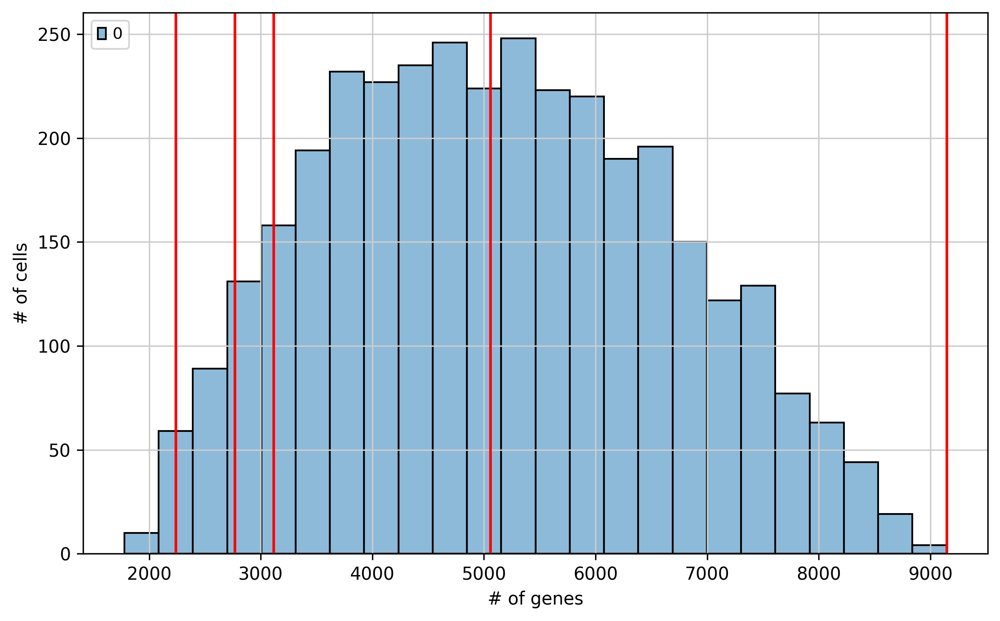

In [168]:
fig, ax = plt.subplots(1, 1, figsize=(8, 5), dpi=150)
sns.histplot(nGenesDetectedPerCell, kde=False, bins='fd')
for i,x in enumerate(percentiles):
    fig.gca().axvline(x=x, ymin=0,ymax=1, color='red')
    # ax.text(x=x, y=ax.get_ylim()[1], s=f'{int(x)} ({percentiles.index.values[i]*100}%)', color='red', rotation=30, size='x-small',rotation_mode='anchor' )
ax.set_xlabel('# of genes')
ax.set_ylabel('# of cells')
fig.tight_layout()

In [169]:
!pyscenic aucell \
    {f_loom_path_scenic} \
    reg.csv \
    --output {f_pyscenic_output} \
    --num_workers 36


2025-02-20 21:19:38,672 - pyscenic.cli.pyscenic - INFO - Loading expression matrix.

2025-02-20 21:19:39,949 - pyscenic.cli.pyscenic - INFO - Loading gene signatures.
Create regulons from a dataframe of enriched features.
Additional columns saved: []

2025-02-20 21:19:40,242 - pyscenic.cli.pyscenic - INFO - Calculating cellular enrichment.

2025-02-20 21:20:04,904 - pyscenic.cli.pyscenic - INFO - Writing results to file.


### Visualization of SCENIC's AUC matrix

In [15]:
import json
import zlib
import base64

# collect SCENIC AUCell output
lf = lp.connect( f_pyscenic_output, mode='r+', validate=False )
auc_mtx = pd.DataFrame( lf.ca.RegulonsAUC, index=lf.ca.CellID)
lf.close()

In [16]:
import umap

# UMAP
runUmap = umap.UMAP(n_neighbors=10, min_dist=0.4, metric='correlation').fit_transform
dr_umap = runUmap( auc_mtx )
pd.DataFrame(dr_umap, columns=['X', 'Y'], index=auc_mtx.index).to_csv( "scenic_umap.txt", sep='\t')
# tSNE
tsne = TSNE( n_jobs=36 )
dr_tsne = tsne.fit_transform( auc_mtx )
pd.DataFrame(dr_tsne, columns=['X', 'Y'], index=auc_mtx.index).to_csv( "scenic_tsne.txt", sep='\t')

/home/18parkky/anaconda3-2021.11/envs/pyscenic/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


<Axes: xlabel='X', ylabel='Y'>

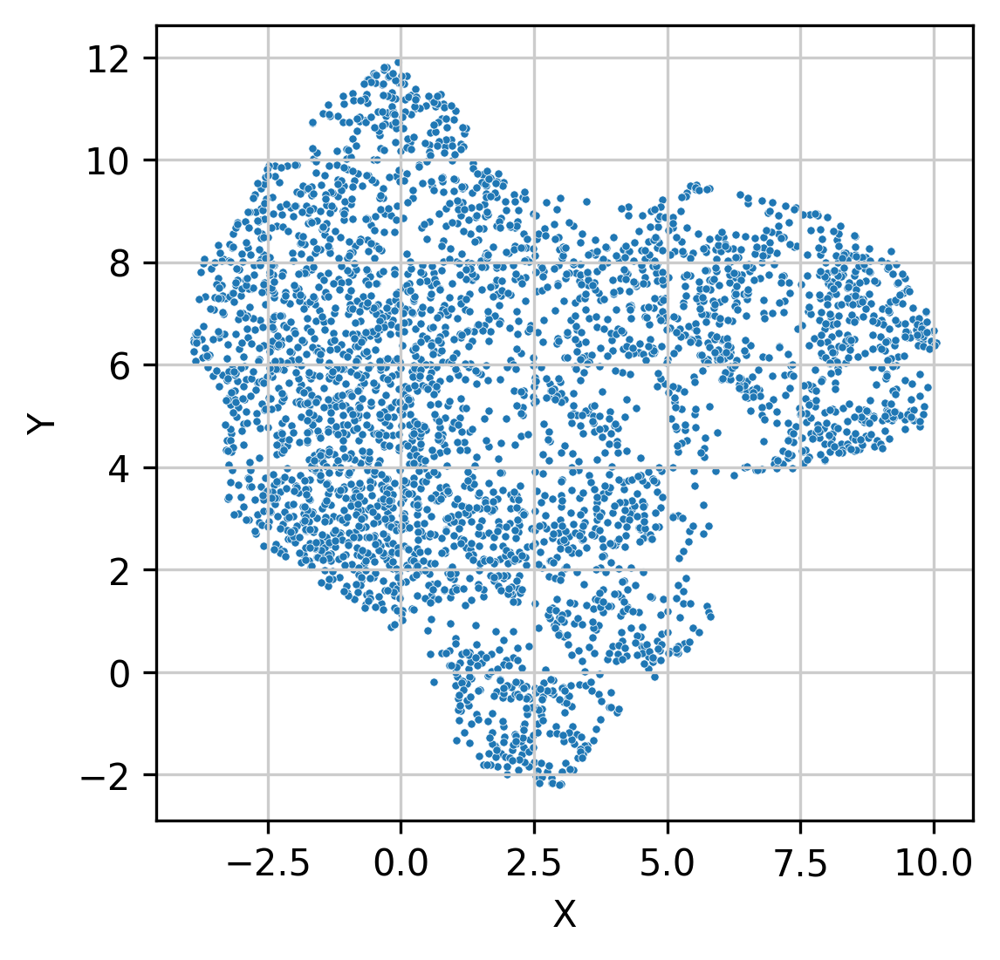

In [216]:
sns.scatterplot(data=pd.DataFrame(dr_umap, columns=['X', 'Y']), x='X', y='Y', alpha=1, s=5)

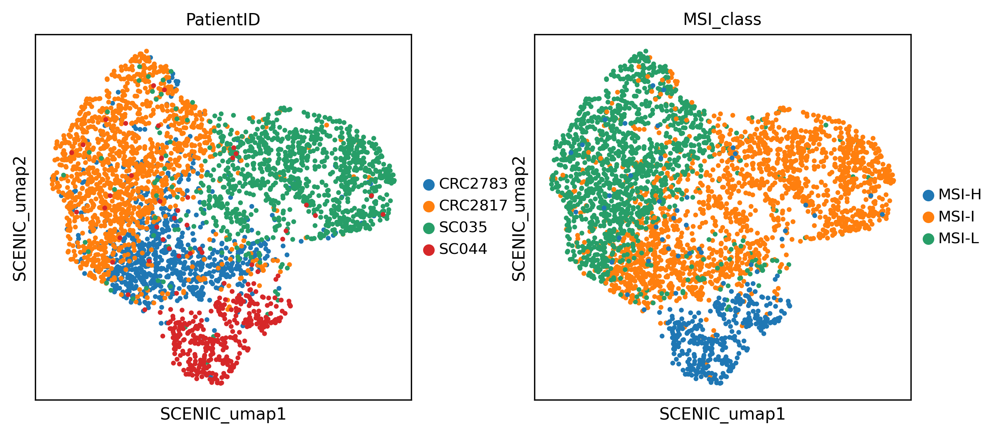

In [217]:
adata_joanito_tumor.obsm['SCENIC_umap'] = np.array( [[tup.X, tup.Y] for tup in pd.DataFrame(dr_umap, columns=['X', 'Y'], index=auc_mtx.index).itertuples()] )
adata_joanito_tumor.obs['MSI_class'] = [ dict_PatientID_to_MSI_class[PID] for PID in adata_joanito_tumor.obs['PatientID'] ]
sc.pl.embedding(adata_joanito_tumor, 'SCENIC_umap', color=['PatientID', 'MSI_class'])

### Integrate outputs

In [34]:
# scenic output
lf = lp.connect( f_pyscenic_output, mode='r+', validate=False )
meta = json.loads(zlib.decompress(base64.b64decode( lf.attrs.MetaData )))
#exprMat = pd.DataFrame( lf[:,:], index=lf.ra.Gene, columns=lf.ca.CellID)
auc_mtx = pd.DataFrame( lf.ca.RegulonsAUC, index=lf.ca.CellID)
regulons = lf.ra.Regulons
dr_umap = pd.read_csv( 'scenic_umap.txt', sep='\t', header=0, index_col=0 )
dr_tsne = pd.read_csv( 'scenic_tsne.txt', sep='\t', header=0, index_col=0 )
###

In [35]:
auc_mtx.columns = auc_mtx.columns.str.replace('\(','_(')
regulons.dtype.names = tuple( [ x.replace("(","_(") for x in regulons.dtype.names ] )
# regulon thresholds
rt = meta['regulonThresholds']
for i,x in enumerate(rt):
    tmp = x.get('regulon').replace("(","_(")
    x.update( {'regulon': tmp} )

In [20]:
tsne = TSNE( n_jobs=20 )
adata_joanito_tumor.obsm['X_tsne'] = tsne.fit_transform( adata_joanito_tumor.X.toarray() )

/tmp/ipykernel_176401/716861371.py:2: ImplicitModificationWarning: Setting element `.obsm['X_tsne']` of view, initializing view as actual.
  adata_joanito_tumor.obsm['X_tsne'] = tsne.fit_transform( adata_joanito_tumor.X.toarray() )


In [36]:
tsneDF = pd.DataFrame(adata_joanito_tumor.obsm['X_tsne'], columns=['_X', '_Y'])

Embeddings_X = pd.DataFrame( index=lf.ca.CellID )
Embeddings_X = pd.concat( [
        pd.DataFrame(adata_joanito_tumor.obsm['X_umap'],index=adata_joanito_tumor.obs.index)[0] ,
        pd.DataFrame(adata_joanito_tumor.obsm['X_pca'],index=adata_joanito_tumor.obs.index)[0] ,
        dr_tsne['X'] ,
        dr_umap['X']
    ], sort=False, axis=1, join='outer' )
Embeddings_X.columns = ['1','2','3','4']

Embeddings_Y = pd.DataFrame( index=lf.ca.CellID )
Embeddings_Y = pd.concat( [
        pd.DataFrame(adata_joanito_tumor.obsm['X_umap'],index=adata_joanito_tumor.obs.index)[1] ,
        pd.DataFrame(adata_joanito_tumor.obsm['X_pca'],index=adata_joanito_tumor.obs.index)[1] ,
        dr_tsne['Y'] ,
        dr_umap['Y']
    ], sort=False, axis=1, join='outer' )
Embeddings_Y.columns = ['1','2','3','4']

In [37]:
### metadata
metaJson = {}

metaJson['embeddings'] = [
    {
        "id": -1,
        "name": f"Scanpy t-SNE (highly variable genes)"
    },
    {
        "id": 1,
        "name": f"Scanpy UMAP  (highly variable genes)"
    },
    {
        "id": 2,
        "name": "Scanpy PC1/PC2"
    },
    {
        "id": 3,
        "name": "SCENIC AUC t-SNE"
    },
    {
        "id": 4,
        "name": "SCENIC AUC UMAP"
    },
]

metaJson["clusterings"] = [{
            "id": 0,
            "group": "Scanpy",
            "name": "Scanpy leiden default resolution",
            "clusters": [],
        }]

metaJson["metrics"] = [
        {
            "name": "nUMI"
        }, {
            "name": "nGene"
        }, {
            "name": "Percent_mito"
        }
]

metaJson["annotations"] = [
    {
        "name": "leiden_clusters_Scanpy",
        "values": list(set( adata_joanito_tumor.obs['leiden'].astype(str) ))
    },
    #{
    #    "name": "Genotype",
    #    "values": list(set(adata.obs['Genotype'].values))
    #},
    #{
    #    "name": "Timepoint",
    #    "values": list(set(adata.obs['Timepoint'].values))
    #},
    #{
    #    "name": "Sample",
    #    "values": list(set(adata.obs['Sample'].values))
    #}
]

# SCENIC regulon thresholds:
metaJson["regulonThresholds"] = rt

for i in range(max(set([int(x) for x in adata_joanito_tumor.obs['leiden']])) + 1):
    clustDict = {}
    clustDict['id'] = i
    clustDict['description'] = f'Unannotated Cluster {i + 1}'
    metaJson['clusterings'][0]['clusters'].append(clustDict)
    
clusterings = pd.DataFrame()
clusterings["0"] = adata_joanito_tumor.obs['leiden'].values.astype(np.int64)

In [38]:
def dfToNamedMatrix(df):
    arr_ip = [tuple(i) for i in df.values]
    dtyp = np.dtype(list(zip(df.dtypes.index, df.dtypes)))
    arr = np.array(arr_ip, dtype=dtyp)
    return arr


col_attrs = {
    "CellID": np.array(adata_joanito_tumor.obs.index),
    "leiden_clusters_Scanpy": np.array( adata_joanito_tumor.obs['leiden'].values ),
    "Embedding": dfToNamedMatrix(tsneDF),
    "Embeddings_X": dfToNamedMatrix(Embeddings_X),
    "Embeddings_Y": dfToNamedMatrix(Embeddings_Y),
    "RegulonsAUC": dfToNamedMatrix(auc_mtx),
    "Clusterings": dfToNamedMatrix(clusterings),
    "ClusterID": np.array(adata_joanito_tumor.obs['leiden'].values)
}

row_attrs = {
    "Gene": lf.ra.Gene,
    "Regulons": regulons,
}

attrs = {
    "title": "sampleTitle",
    "MetaData": json.dumps(metaJson),
    "Genome": 'hg38',
    "SCopeTreeL1": "",
    "SCopeTreeL2": "",
    "SCopeTreeL3": ""
}

# compress the metadata field:
attrs['MetaData'] = base64.b64encode(zlib.compress(json.dumps(metaJson).encode('ascii'))).decode('ascii')

In [24]:
f_final_loom

'Joanito_tumor_epi_scenic_integrated-output.loom'

In [40]:
f_final_loom

'Joanito_tumor_epi_scenic_integrated-output.loom'

In [41]:
lp.create(
    filename = 'Joanito_tumor_epi_scenic_integrated-output2.loom',
    layers=lf[:,:],
    row_attrs=row_attrs, 
    col_attrs=col_attrs, 
    file_attrs=attrs
)
lf.close() # close original pyscenic loom file

### Extract relevant data from the integrated loom file

In [42]:
f_final_loom = 'Joanito_tumor_epi_scenic_integrated-output2.loom'

In [43]:
# scenic output
lf = lp.connect( f_final_loom, mode='r', validate=False )
meta = json.loads(zlib.decompress(base64.b64decode( lf.attrs.MetaData )))
exprMat = pd.DataFrame( lf[:,:], index=lf.ra.Gene, columns=lf.ca.CellID).T
auc_mtx = pd.DataFrame( lf.ca.RegulonsAUC, index=lf.ca.CellID)

In [44]:
# create a dictionary of regulons:
regulons = {}
for i,r in pd.DataFrame(lf.ra.Regulons,index=lf.ra.Gene).items():
    regulons[i] =  list(r[r==1].index.values)

In [45]:
# cell annotations from the loom column attributes:
cellAnnot = pd.concat(
    [
        pd.DataFrame( lf.ca.ClusterID, index=lf.ca.CellID ),
        pd.DataFrame( lf.ca.leiden_clusters_Scanpy, index=lf.ca.CellID ),
        # pd.DataFrame( lf.ca.Embeddings_X, index=lf.ca.CellID ),
        # pd.DataFrame( lf.ca.Embeddings_Y, index=lf.ca.CellID ),
        # pd.DataFrame( lf.ca.RegulonsAUC, index=lf.ca.CellID ),
    ],
    axis=1
)

cellAnnot.columns = [
 'ClusterID',
 'leiden_clusters_Scanpy',]

In [46]:
# capture embeddings:
dr = [
    pd.DataFrame( lf.ca.Embedding, index=lf.ca.CellID )
]
dr_names = [
    meta['embeddings'][0]['name'].replace(" ","_")
]

# add other embeddings
drx = pd.DataFrame( lf.ca.Embeddings_X, index=lf.ca.CellID )
dry = pd.DataFrame( lf.ca.Embeddings_Y, index=lf.ca.CellID )

for i in range( len(drx.columns) ):
    dr.append( pd.concat( [ drx.iloc[:,i], dry.iloc[:,i] ], sort=False, axis=1, join='outer' ))
    dr_names.append( meta['embeddings'][i+1]['name'].replace(" ","_").replace('/','-') )

# rename columns:
for i,x in enumerate( dr ):
    x.columns = ['X','Y']

In [54]:
print(type(adata.obs))  # Should be a pandas DataFrame


<class 'pandas.core.frame.DataFrame'>


In [151]:
adata = sc.read( f_final_loom, validate=False)
adata.obs['Clusterings'] = adata.obs['Clusterings'].astype(str)

--> This might be very slow. Consider passing `cache=True`, which enables much faster reading from a cache file.


In [152]:
adata.obs['Clusterings'] = [ int(c.split(',')[0].split('(')[1]) for c in adata.obs['Clusterings'] ]

In [153]:
adata.obs['Embedding'] = adata.obs['Embedding'].astype('category')
adata.obs['Embeddings_X'] = adata.obs['Embeddings_X'].astype('category')
adata.obs['Embeddings_Y'] = adata.obs['Embeddings_Y'].astype('category')
adata.obs['RegulonsAUC'] = adata.obs['RegulonsAUC'].astype('category')
adata.var['Regulons'] = adata.var['Regulons'].astype('category')

In [156]:
adata.obs.drop( ['Embedding','Embeddings_X','Embeddings_Y','RegulonsAUC'], axis=1, inplace=True )

In [157]:
# add the embeddings into the adata.obsm object
for i,x in enumerate( dr ):
    adata.obsm[ 'X_'+dr_names[i] ] = x.values

In [158]:
adata

AnnData object with n_obs × n_vars = 3490 × 29511
    obs: 'ClusterID', 'Clusterings', 'leiden_clusters_Scanpy'
    var: 'Regulons'
    obsm: 'X_Scanpy_t-SNE_(highly_variable_genes)', 'X_Scanpy_UMAP__(highly_variable_genes)', 'X_Scanpy_PC1-PC2', 'X_SCENIC_AUC_t-SNE', 'X_SCENIC_AUC_UMAP'

In [159]:
# load the regulons from a file using the load_signatures function
sig = load_signatures('reg.csv')
adata = add_scenic_metadata(adata, auc_mtx, sig)

Create regulons from a dataframe of enriched features.
Additional columns saved: []


In [210]:
dict_CB_to_PatientID = { tup.Index : tup.PatientID for tup in adata_joanito_tumor.obs.itertuples() }
cellAnnot['PatientID'] = [ dict_CB_to_PatientID[CB] for CB in cellAnnot.index ]
cellAnnot['MSI_class'] = [ dict_PatientID_to_MSI_class[PID] for PID in cellAnnot['PatientID'] ]
cellAnnot

,ClusterID,leiden_clusters_Scanpy,PatientID,MSI_class
AAACGGGTCGAGGTAG-1,6,6,CRC2783,MSI-I
AAAGCAAAGATCACGG-1,6,6,CRC2783,MSI-I
AACCATGCAGCCTGTG-1,6,6,CRC2783,MSI-I
AACCATGGTCAATACC-1,6,6,CRC2783,MSI-I
AACCGCGAGGCGCTCT-1,6,6,CRC2783,MSI-I
...,...,...,...,...
GCGACCACAGCTTCGG-1,6,6,SC044,MSI-H
GCTCTGTCAATAACGA-1,6,6,SC044,MSI-H
GTCACGGCAGTCCTTC-1,6,6,SC044,MSI-H
TCAGGTAGTTGATTGC-1-1,6,6,SC044,MSI-H


###  Regulon specificity scores (RSS) across predicted cell types

In [179]:
from math import sqrt

import numpy as np
import pandas as pd
from scipy.spatial.distance import jensenshannon

def regulon_specificity_scores(auc_mtx, cell_type_series):
    """
    Calculates the Regulon Specificty Scores (RSS). [doi: 10.1016/j.celrep.2018.10.045]

    :param auc_mtx: The dataframe with the AUC values for all cells and regulons (n_cells x n_regulons).
    :param cell_type_series: A pandas Series object with cell identifiers as index and cell type labels as values.
    :return: A pandas dataframe with the RSS values (cell type x regulon).
    """

    cell_types = list(cell_type_series.unique())
    n_types = len(cell_types)
    regulons = list(auc_mtx.columns)
    n_regulons = len(regulons)
    rss_values = np.empty(shape=(n_types, n_regulons), dtype=float) # dtype=np.float changed to dtype=float

    def rss(aucs, labels):
        # jensenshannon function provides distance which is the sqrt of the JS divergence.
        return 1.0 - jensenshannon(aucs / aucs.sum(), labels / labels.sum())

    for cidx, regulon_name in enumerate(regulons):
        for ridx, cell_type in enumerate(cell_types):
            rss_values[ridx, cidx] = rss(
                auc_mtx[regulon_name], (cell_type_series == cell_type).astype(int)
            )

    return pd.DataFrame(data=rss_values, index=cell_types, columns=regulons)


In [211]:
rss_cellType = regulon_specificity_scores( auc_mtx, cellAnnot['MSI_class'] )
rss_cellType

,ATF3(+),CDX1(+),CHURC1(+),ELF1(+),ELF3(+),ETV6(+),FOS(+),FOXM1(+),HOXA10(+),ILF2(+),...,NFIA(+),NFIB(+),PAX4(+),PPARG(+),SATB2(+),SIRT6(+),TCF12(+),TCF7L2(+),TFDP2(+),YBX1(+)
MSI-I,0.409991,0.549314,0.563249,0.362042,0.389872,0.444379,0.391178,0.539385,0.496910,0.560178,...,0.523839,0.518503,0.188986,0.281606,0.395334,0.465253,0.351218,0.403262,0.493890,0.565427
MSI-L,0.549145,0.370702,0.418618,0.501709,0.566977,0.526751,0.513315,0.375680,0.396376,0.427791,...,0.442179,0.439463,0.191212,0.556813,0.214810,0.417194,0.440744,0.533048,0.443169,0.436242
MSI-H,0.258303,0.194791,0.276868,0.195227,0.249755,0.249100,0.276988,0.298670,0.405083,0.294999,...,0.299921,0.309731,0.175714,0.185438,0.184325,0.196245,0.316685,0.243536,0.258908,0.286420


In [ ]:
cats = sorted(list(set(cellAnnot['MSI_class'])))

fig = plt.figure(figsize=(15, 8))
for c,num in zip(cats, range(1,len(cats)+1)):
    x=rss_cellType.T[c]
    ax = fig.add_subplot(2,5,num)
    plot_rss(rss_cellType, c, top_n=5, max_n=None, ax=ax)
    ax.set_ylim( x.min()-(x.max()-x.min())*0.05 , x.max()+(x.max()-x.min())*0.05 )
    for t in ax.texts:
        t.set_fontsize(12)
    ax.set_ylabel('')
    ax.set_xlabel('')
    # adjust_text(ax.texts, autoalign='xy', ha='right', va='bottom', arrowprops=dict(arrowstyle='-',color='lightgrey'), precision=0.001 )
 
fig.text(0.5, 0.0, 'Regulon', ha='center', va='center', size='x-large')
fig.text(0.00, 0.5, 'Regulon specificity score (RSS)', ha='center', va='center', rotation='vertical', size='x-large')
plt.tight_layout()
plt.rcParams.update({
    'figure.autolayout': True,
        'figure.titlesize': 'large' ,
        'axes.labelsize': 'medium',
        'axes.titlesize':'large',
        'xtick.labelsize':'medium',
        'ytick.labelsize':'medium'
        })
plt.savefig("PBMC10k_cellType-RSS-top5.pdf", dpi=600, bbox_inches = "tight")
plt.show()

In [213]:
topreg = []
for i,c in enumerate(cats):
    topreg.extend(
        list(rss_cellType.T[c].sort_values(ascending=False)[:5].index)
    )
topreg = list(set(topreg))

In [214]:
auc_mtx_Z = pd.DataFrame( index=auc_mtx.index )
for col in list(auc_mtx.columns):
    auc_mtx_Z[ col ] = ( auc_mtx[col] - auc_mtx[col].mean()) / auc_mtx[col].std(ddof=0)
#auc_mtx_Z.sort_index(inplace=True)

In [216]:
def palplot(pal, names, colors=None, size=1):
    n = len(pal)
    f, ax = plt.subplots(1, 1, figsize=(n * size, size))
    ax.imshow(np.arange(n).reshape(1, n),
              cmap=mpl.colors.ListedColormap(list(pal)),
              interpolation="nearest", aspect="auto")
    ax.set_xticks(np.arange(n) - .5)
    ax.set_yticks([-.5, .5])
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    colors = n * ['k'] if colors is None else colors
    for idx, (name, color) in enumerate(zip(names, colors)):
        ax.text(0.0+idx, 0.0, name, color=color, horizontalalignment='center', verticalalignment='center')
    return f

colors = sns.color_palette('bright',n_colors=len(cats) )
colorsd = dict( zip( cats, colors ))
colormap = [ colorsd[x] for x in cellAnnot['MSI_class'] ]

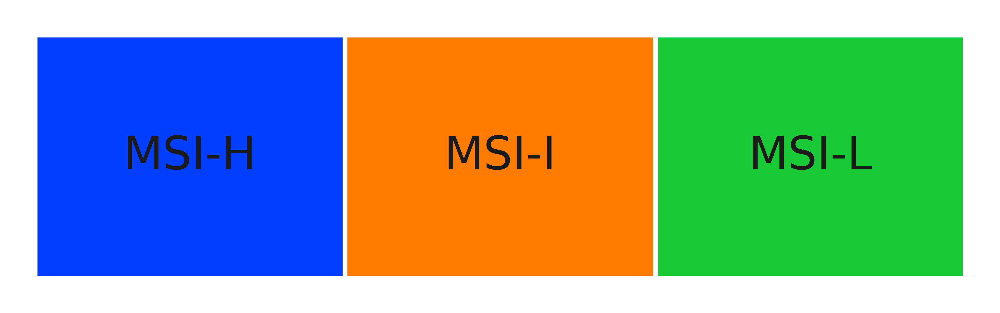

In [217]:
sns.set()
sns.set(font_scale=0.8)
fig = palplot( colors, cats, size=1.0)
# plt.savefig("PBMC10k_cellType-heatmap-legend-top5.pdf", dpi=600, bbox_inches = "tight")

In [ ]:
sns.set(font_scale=1.2)
g = sns.clustermap(auc_mtx_Z[topreg], annot=False,  square=False,  linecolor='gray',
    yticklabels=False, xticklabels=True, vmin=-2, vmax=6, row_colors=colormap,
    cmap="YlGnBu", figsize=(21,16) )
g.cax.set_visible(True)
g.ax_heatmap.set_ylabel('')
g.ax_heatmap.set_xlabel('')
# plt.savefig("PBMC10k_cellType-heatmap-top5.pdf", dpi=600, bbox_inches = "tight")

In [220]:
auc_mtx_Z.to_csv('/node200data/18parkky/datasets/data/public/processed_data/Joanito_et_al/3_GeneExpressionAnalysis/SCENIC/auc_mtx_Z.tsv', sep='\t')

## pySCENIC pipeline (Chen et al)

### Set directories and load files

In [221]:
# set variables for file paths to read from and write to:

# set a working directory
wdir = "/node200data/18parkky/datasets/data/public/processed_data/Immunotherapy_CRC_Chen_et_al/3_GeneExpressionAnalysis/SCENIC"
os.chdir( wdir )

# path to unfiltered loom file (this will be created in the optional steps below)
f_loom_path_unfilt = "Chen_tumor_epi_unfiltered.loom" # test dataset, n=500 cells

# # path to loom file with basic filtering applied (this will be created in the "initial filtering" step below). Optional.
f_loom_path_scenic = "Chen_tumor_epi_filtered_scenic.loom"

# path to anndata object, which will be updated to store Scanpy results as they are generated below
f_anndata_path = "anndata.h5ad"

# path to pyscenic output
f_pyscenic_output = "pyscenic_output.loom"

# loom output, generated from a combination of Scanpy and pySCENIC results:
f_final_loom = 'Chen_tumor_epi_scenic_integrated-output.loom'

In [223]:
adata_chen = adata_chen.raw.to_adata()

In [224]:
sc.pl.umap(adata_chen, color=['Manual_CellType_lvl_2'])

/home/18parkky/anaconda3-2021.11/envs/pyscenic/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  fig.canvas.print_figure(bytes_io, **kw)


### Step 1: Gene regulatory network inference, and generation of co-expression modules

In [226]:
adata_chen_tumor = adata_chen[(adata_chen.obs['Manual_CellType_lvl_1']=='Tumor epithelial') & 
                                    (adata_chen.obs['MSI']=='MSI')]

In [227]:
# create basic row and column attributes for the loom file:
row_attrs = {
    "Gene": np.array(adata_chen_tumor.var_names) ,
}
col_attrs = {
    "CellID": np.array(adata_chen_tumor.obs_names) ,
    "nGene": np.array( np.sum(adata_chen_tumor.X.transpose()>0 , axis=0)).flatten() ,
    "nUMI": np.array( np.sum(adata_chen_tumor.X.transpose() , axis=0)).flatten() ,
}
lp.create( f_loom_path_scenic, adata_chen_tumor.X.transpose(), row_attrs, col_attrs)

In [228]:
f_tfs = "/node200data/18parkky/datasets/reference/z_program_references/pyscenic/homo_sapiens/allTFs_hg38.txt" # human
!pyscenic grn {f_loom_path_scenic} {f_tfs} -o adj.csv --num_workers 48


2025-02-23 16:31:39,726 - pyscenic.cli.pyscenic - INFO - Loading expression matrix.

2025-02-23 16:31:43,703 - pyscenic.cli.pyscenic - INFO - Inferring regulatory networks.
/home/18parkky/anaconda3-2021.11/envs/pyscenic/lib/python3.10/site-packages/distributed/node.py:182: UserWarning: Port 8787 is already in use.
Perhaps you already have a cluster running?
Hosting the HTTP server on port 41625 instead
  warnings.warn(
preparing dask client
parsing input
creating dask graph
48 partitions
computing dask graph
/home/18parkky/anaconda3-2021.11/envs/pyscenic/lib/python3.10/site-packages/distributed/client.py:3169: UserWarning: Sending large graph of size 1.47 GiB.
This may cause some slowdown.
Consider scattering data ahead of time and using futures.
  warnings.warn(
not shutting down client, client was created externally
finished

2025-02-23 16:50:19,792 - pyscenic.cli.pyscenic - INFO - Writing results to file.


In [229]:
adjacencies = pd.read_csv(f"adj.csv", index_col=False, sep=',')

In [230]:
adjacencies.head()

,TF,target,importance
0,RPL6,RPS7,33.334816
1,RPS4X,RPL14,28.638867
2,RPS4X,RPL19,24.233241
3,RPL6,RPL15,23.912784
4,RPS4X,RPS5,22.237646


### Step 2-3. Regulon prediction aka cisTarget from CLI

In [231]:
# ranking databases
f_db_glob = "/node200data/18parkky/datasets/reference/z_program_references/pyscenic/homo_sapiens/*feather"
f_db_names = ' '.join( glob.glob(f_db_glob) )

# motif databases
f_motif_path = "/node200data/18parkky/datasets/reference/z_program_references/pyscenic/homo_sapiens/motifs-v10nr_clust-nr.hgnc-m0.001-o0.0.tbl"

In [232]:
!pyscenic ctx adj.csv \
    {f_db_names} \
    --annotations_fname {f_motif_path} \
    --expression_mtx_fname {f_loom_path_scenic} \
    --output reg.csv \
    --num_workers 48
    # --mask_dropouts \


2025-02-23 16:52:43,530 - pyscenic.cli.pyscenic - INFO - Creating modules.

2025-02-23 16:52:44,498 - pyscenic.cli.pyscenic - INFO - Loading expression matrix.

2025-02-23 16:52:55,490 - pyscenic.utils - INFO - Calculating Pearson correlations.

2025-02-23 16:52:55,967 - pyscenic.utils - WARNING - Note on correlation calculation: the default behaviour for calculating the correlations has changed after pySCENIC verion 0.9.16. Previously, the default was to calculate the correlation between a TF and target gene using only cells with non-zero expression values (mask_dropouts=True). The current default is now to use all cells to match the behavior of the R verision of SCENIC. The original settings can be retained by setting 'rho_mask_dropouts=True' in the modules_from_adjacencies function, or '--mask_dropouts' from the CLI.
	Dropout masking is currently set to [False].

2025-02-23 16:55:26,697 - pyscenic.utils - INFO - Creating modules.

2025-02-23 16:56:47,611 - pyscenic.cli.pyscenic - I

### Step 4. Cellular enrichment (aka AUCell) from CLI

In [233]:
nGenesDetectedPerCell = np.sum(adata_chen_tumor.X>0, axis=1)
percentiles = np.quantile(np.array(nGenesDetectedPerCell).ravel(), [.01, .05, .10, .50, 1])
print(percentiles)

[ 790.   911.4  998.  1787.  7154. ]


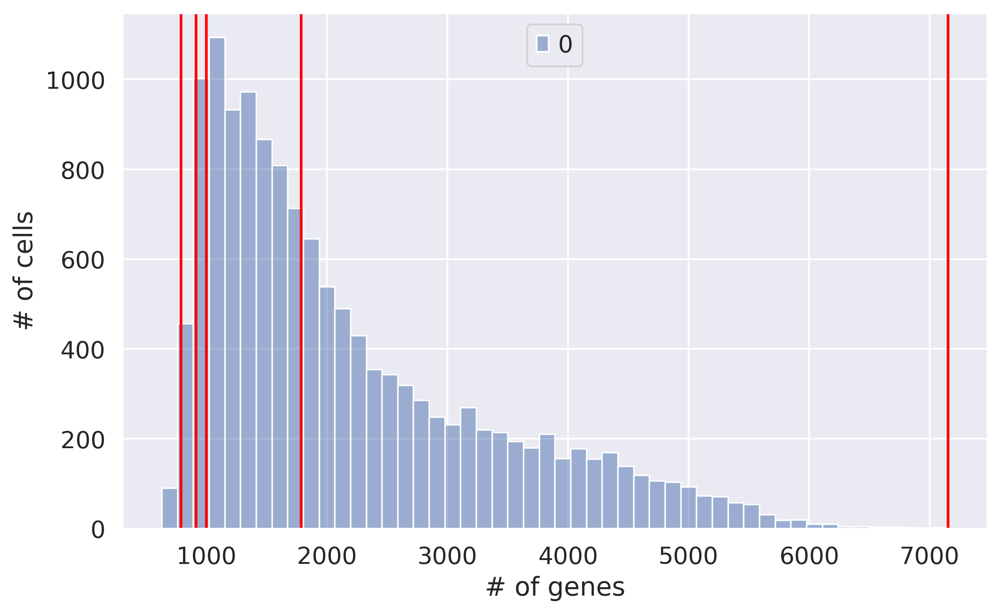

In [234]:
fig, ax = plt.subplots(1, 1, figsize=(8, 5), dpi=150)
sns.histplot(nGenesDetectedPerCell, kde=False, bins='fd')
for i,x in enumerate(percentiles):
    fig.gca().axvline(x=x, ymin=0,ymax=1, color='red')
    # ax.text(x=x, y=ax.get_ylim()[1], s=f'{int(x)} ({percentiles.index.values[i]*100}%)', color='red', rotation=30, size='x-small',rotation_mode='anchor' )
ax.set_xlabel('# of genes')
ax.set_ylabel('# of cells')
fig.tight_layout()

In [235]:
!pyscenic aucell \
    {f_loom_path_scenic} \
    reg.csv \
    --output {f_pyscenic_output} \
    --num_workers 48


2025-02-23 17:05:10,150 - pyscenic.cli.pyscenic - INFO - Loading expression matrix.

2025-02-23 17:05:14,238 - pyscenic.cli.pyscenic - INFO - Loading gene signatures.
Create regulons from a dataframe of enriched features.
Additional columns saved: []

2025-02-23 17:05:14,671 - pyscenic.cli.pyscenic - INFO - Calculating cellular enrichment.

2025-02-23 17:06:54,468 - pyscenic.cli.pyscenic - INFO - Writing results to file.


### Visualization of SCENIC's AUC matrix

In [236]:
import json
import zlib
import base64

# collect SCENIC AUCell output
lf = lp.connect( f_pyscenic_output, mode='r+', validate=False )
auc_mtx = pd.DataFrame( lf.ca.RegulonsAUC, index=lf.ca.CellID)
lf.close()

In [237]:
import umap

# UMAP
runUmap = umap.UMAP(n_neighbors=10, min_dist=0.4, metric='correlation').fit_transform
dr_umap = runUmap( auc_mtx )
pd.DataFrame(dr_umap, columns=['X', 'Y'], index=auc_mtx.index).to_csv( "scenic_umap.txt", sep='\t')
# tSNE
tsne = TSNE( n_jobs=36 )
dr_tsne = tsne.fit_transform( auc_mtx )
pd.DataFrame(dr_tsne, columns=['X', 'Y'], index=auc_mtx.index).to_csv( "scenic_tsne.txt", sep='\t')

In [244]:
adata_chen_tumor.obsm['SCENIC_umap'] = np.array( [[tup.X, tup.Y] for tup in pd.DataFrame(dr_umap, columns=['X', 'Y'], index=auc_mtx.index).itertuples()] )
adata_chen_tumor.obs['MSI_class'] = [ dict_PatientID_to_MSI_class[PID] for PID in adata_chen_tumor.obs['PatientID'] ]
sc.pl.embedding(adata_chen_tumor, 'SCENIC_umap', color=['PatientID', 'MSI_class', 'Response'])

/home/18parkky/anaconda3-2021.11/envs/pyscenic/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.canvas.print_figure(bytes_io, **kw)


### Integrate outputs

In [245]:
# scenic output
lf = lp.connect( f_pyscenic_output, mode='r+', validate=False )
meta = json.loads(zlib.decompress(base64.b64decode( lf.attrs.MetaData )))
#exprMat = pd.DataFrame( lf[:,:], index=lf.ra.Gene, columns=lf.ca.CellID)
auc_mtx = pd.DataFrame( lf.ca.RegulonsAUC, index=lf.ca.CellID)
regulons = lf.ra.Regulons
dr_umap = pd.read_csv( 'scenic_umap.txt', sep='\t', header=0, index_col=0 )
dr_tsne = pd.read_csv( 'scenic_tsne.txt', sep='\t', header=0, index_col=0 )
###

In [246]:
auc_mtx.columns = auc_mtx.columns.str.replace('\(','_(')
regulons.dtype.names = tuple( [ x.replace("(","_(") for x in regulons.dtype.names ] )
# regulon thresholds
rt = meta['regulonThresholds']
for i,x in enumerate(rt):
    tmp = x.get('regulon').replace("(","_(")
    x.update( {'regulon': tmp} )

In [247]:
tsne = TSNE( n_jobs=48 )
adata_chen_tumor.obsm['X_tsne'] = tsne.fit_transform( adata_chen_tumor.X.toarray() )

In [248]:
tsneDF = pd.DataFrame(adata_chen_tumor.obsm['X_tsne'], columns=['_X', '_Y'])

Embeddings_X = pd.DataFrame( index=lf.ca.CellID )
Embeddings_X = pd.concat( [
        pd.DataFrame(adata_chen_tumor.obsm['X_umap'],index=adata_chen_tumor.obs.index)[0] ,
        pd.DataFrame(adata_chen_tumor.obsm['X_pca'],index=adata_chen_tumor.obs.index)[0] ,
        dr_tsne['X'] ,
        dr_umap['X']
    ], sort=False, axis=1, join='outer' )
Embeddings_X.columns = ['1','2','3','4']

Embeddings_Y = pd.DataFrame( index=lf.ca.CellID )
Embeddings_Y = pd.concat( [
        pd.DataFrame(adata_chen_tumor.obsm['X_umap'],index=adata_chen_tumor.obs.index)[1] ,
        pd.DataFrame(adata_chen_tumor.obsm['X_pca'],index=adata_chen_tumor.obs.index)[1] ,
        dr_tsne['Y'] ,
        dr_umap['Y']
    ], sort=False, axis=1, join='outer' )
Embeddings_Y.columns = ['1','2','3','4']

In [251]:
adata_chen_tumor.obs['leiden'] = '1'

In [252]:
### metadata
metaJson = {}

metaJson['embeddings'] = [
    {
        "id": -1,
        "name": f"Scanpy t-SNE (highly variable genes)"
    },
    {
        "id": 1,
        "name": f"Scanpy UMAP  (highly variable genes)"
    },
    {
        "id": 2,
        "name": "Scanpy PC1/PC2"
    },
    {
        "id": 3,
        "name": "SCENIC AUC t-SNE"
    },
    {
        "id": 4,
        "name": "SCENIC AUC UMAP"
    },
]

metaJson["clusterings"] = [{
            "id": 0,
            "group": "Scanpy",
            "name": "Scanpy leiden default resolution",
            "clusters": [],
        }]

metaJson["metrics"] = [
        {
            "name": "nUMI"
        }, {
            "name": "nGene"
        }, {
            "name": "Percent_mito"
        }
]

metaJson["annotations"] = [
    {
        "name": "leiden_clusters_Scanpy",
        "values": list(set( adata_chen_tumor.obs['leiden'].astype(str) ))
    },
    #{
    #    "name": "Genotype",
    #    "values": list(set(adata.obs['Genotype'].values))
    #},
    #{
    #    "name": "Timepoint",
    #    "values": list(set(adata.obs['Timepoint'].values))
    #},
    #{
    #    "name": "Sample",
    #    "values": list(set(adata.obs['Sample'].values))
    #}
]

# SCENIC regulon thresholds:
metaJson["regulonThresholds"] = rt

for i in range(max(set([int(x) for x in adata_chen_tumor.obs['leiden']])) + 1):
    clustDict = {}
    clustDict['id'] = i
    clustDict['description'] = f'Unannotated Cluster {i + 1}'
    metaJson['clusterings'][0]['clusters'].append(clustDict)
    
clusterings = pd.DataFrame()
clusterings["0"] = adata_chen_tumor.obs['leiden'].values.astype(np.int64)

In [253]:
def dfToNamedMatrix(df):
    arr_ip = [tuple(i) for i in df.values]
    dtyp = np.dtype(list(zip(df.dtypes.index, df.dtypes)))
    arr = np.array(arr_ip, dtype=dtyp)
    return arr


col_attrs = {
    "CellID": np.array(adata_chen_tumor.obs.index),
    "leiden_clusters_Scanpy": np.array( adata_chen_tumor.obs['leiden'].values ),
    "Embedding": dfToNamedMatrix(tsneDF),
    "Embeddings_X": dfToNamedMatrix(Embeddings_X),
    "Embeddings_Y": dfToNamedMatrix(Embeddings_Y),
    "RegulonsAUC": dfToNamedMatrix(auc_mtx),
    "Clusterings": dfToNamedMatrix(clusterings),
    "ClusterID": np.array(adata_chen_tumor.obs['leiden'].values)
}

row_attrs = {
    "Gene": lf.ra.Gene,
    "Regulons": regulons,
}

attrs = {
    "title": "sampleTitle",
    "MetaData": json.dumps(metaJson),
    "Genome": 'hg38',
    "SCopeTreeL1": "",
    "SCopeTreeL2": "",
    "SCopeTreeL3": ""
}

# compress the metadata field:
attrs['MetaData'] = base64.b64encode(zlib.compress(json.dumps(metaJson).encode('ascii'))).decode('ascii')

In [254]:
f_final_loom

'Chen_tumor_epi_scenic_integrated-output.loom'

In [255]:
lp.create(
    filename = f_final_loom,
    layers=lf[:,:],
    row_attrs=row_attrs, 
    col_attrs=col_attrs, 
    file_attrs=attrs
)
lf.close() # close original pyscenic loom file

### Extract relevant data from the integrated loom file

In [256]:
# scenic output
lf = lp.connect( f_final_loom, mode='r', validate=False )
meta = json.loads(zlib.decompress(base64.b64decode( lf.attrs.MetaData )))
exprMat = pd.DataFrame( lf[:,:], index=lf.ra.Gene, columns=lf.ca.CellID).T
auc_mtx = pd.DataFrame( lf.ca.RegulonsAUC, index=lf.ca.CellID)

In [257]:
# create a dictionary of regulons:
regulons = {}
for i,r in pd.DataFrame(lf.ra.Regulons,index=lf.ra.Gene).items():
    regulons[i] =  list(r[r==1].index.values)

In [258]:
# cell annotations from the loom column attributes:
cellAnnot = pd.concat(
    [
        pd.DataFrame( lf.ca.ClusterID, index=lf.ca.CellID ),
        pd.DataFrame( lf.ca.leiden_clusters_Scanpy, index=lf.ca.CellID ),
        # pd.DataFrame( lf.ca.Embeddings_X, index=lf.ca.CellID ),
        # pd.DataFrame( lf.ca.Embeddings_Y, index=lf.ca.CellID ),
        # pd.DataFrame( lf.ca.RegulonsAUC, index=lf.ca.CellID ),
    ],
    axis=1
)

cellAnnot.columns = [
 'ClusterID',
 'leiden_clusters_Scanpy',]

In [259]:
# capture embeddings:
dr = [
    pd.DataFrame( lf.ca.Embedding, index=lf.ca.CellID )
]
dr_names = [
    meta['embeddings'][0]['name'].replace(" ","_")
]

# add other embeddings
drx = pd.DataFrame( lf.ca.Embeddings_X, index=lf.ca.CellID )
dry = pd.DataFrame( lf.ca.Embeddings_Y, index=lf.ca.CellID )

for i in range( len(drx.columns) ):
    dr.append( pd.concat( [ drx.iloc[:,i], dry.iloc[:,i] ], sort=False, axis=1, join='outer' ))
    dr_names.append( meta['embeddings'][i+1]['name'].replace(" ","_").replace('/','-') )

# rename columns:
for i,x in enumerate( dr ):
    x.columns = ['X','Y']

In [260]:
adata = sc.read( f_final_loom, validate=False)
adata.obs['Clusterings'] = adata.obs['Clusterings'].astype(str)
adata.obs['Clusterings'] = [ int(c.split(',')[0].split('(')[1]) for c in adata.obs['Clusterings'] ]
adata.obs['Embedding'] = adata.obs['Embedding'].astype('category')
adata.obs['Embeddings_X'] = adata.obs['Embeddings_X'].astype('category')
adata.obs['Embeddings_Y'] = adata.obs['Embeddings_Y'].astype('category')
adata.obs['RegulonsAUC'] = adata.obs['RegulonsAUC'].astype('category')
adata.var['Regulons'] = adata.var['Regulons'].astype('category')

--> This might be very slow. Consider passing `cache=True`, which enables much faster reading from a cache file.


In [261]:
adata.obs.drop( ['Embedding','Embeddings_X','Embeddings_Y','RegulonsAUC'], axis=1, inplace=True )
# add the embeddings into the adata.obsm object
for i,x in enumerate( dr ):
    adata.obsm[ 'X_'+dr_names[i] ] = x.values

In [262]:
adata

AnnData object with n_obs × n_vars = 13709 × 28974
    obs: 'ClusterID', 'Clusterings', 'leiden_clusters_Scanpy'
    var: 'Regulons'
    obsm: 'X_Scanpy_t-SNE_(highly_variable_genes)', 'X_Scanpy_UMAP__(highly_variable_genes)', 'X_Scanpy_PC1-PC2', 'X_SCENIC_AUC_t-SNE', 'X_SCENIC_AUC_UMAP'

In [263]:
# load the regulons from a file using the load_signatures function
sig = load_signatures('reg.csv')
adata = add_scenic_metadata(adata, auc_mtx, sig)

Create regulons from a dataframe of enriched features.
Additional columns saved: []


In [264]:
dict_CB_to_PatientID = { tup.Index : tup.PatientID for tup in adata_chen_tumor.obs.itertuples() }
cellAnnot['PatientID'] = [ dict_CB_to_PatientID[CB] for CB in cellAnnot.index ]
cellAnnot['MSI_class'] = [ dict_PatientID_to_MSI_class[PID] for PID in cellAnnot['PatientID'] ]
cellAnnot

,ClusterID,leiden_clusters_Scanpy,PatientID,MSI_class
CAAGAAACAAGTTAAG-1,1,1,P04,MSI-H
GAACGGACATTTGCTT-1,1,1,P04,MSI-H
GCTTCCATCTTGACGA-1,1,1,P04,MSI-H
GGAATAAAGTACATGA-1,1,1,P04,MSI-H
AACTTTCCACCAGGTC-1,1,1,P15,MSI-I
...,...,...,...,...
TTTGGTTCACCAGTTA-1,1,1,P26,MSI-I
TTTGGTTTCCAAGCCG-1,1,1,P26,MSI-I
TTTGGTTTCCGGGTGT-1-3,1,1,P26,MSI-I
TTTGTCACACAGATTC-1,1,1,P26,MSI-I


###  Regulon specificity scores (RSS) across predicted cell types

In [265]:
from math import sqrt

import numpy as np
import pandas as pd
from scipy.spatial.distance import jensenshannon

def regulon_specificity_scores(auc_mtx, cell_type_series):
    """
    Calculates the Regulon Specificty Scores (RSS). [doi: 10.1016/j.celrep.2018.10.045]

    :param auc_mtx: The dataframe with the AUC values for all cells and regulons (n_cells x n_regulons).
    :param cell_type_series: A pandas Series object with cell identifiers as index and cell type labels as values.
    :return: A pandas dataframe with the RSS values (cell type x regulon).
    """

    cell_types = list(cell_type_series.unique())
    n_types = len(cell_types)
    regulons = list(auc_mtx.columns)
    n_regulons = len(regulons)
    rss_values = np.empty(shape=(n_types, n_regulons), dtype=float) # dtype=np.float changed to dtype=float

    def rss(aucs, labels):
        # jensenshannon function provides distance which is the sqrt of the JS divergence.
        return 1.0 - jensenshannon(aucs / aucs.sum(), labels / labels.sum())

    for cidx, regulon_name in enumerate(regulons):
        for ridx, cell_type in enumerate(cell_types):
            rss_values[ridx, cidx] = rss(
                auc_mtx[regulon_name], (cell_type_series == cell_type).astype(int)
            )

    return pd.DataFrame(data=rss_values, index=cell_types, columns=regulons)


In [266]:
rss_cellType = regulon_specificity_scores( auc_mtx, cellAnnot['MSI_class'] )
rss_cellType

,ATF3(+),BACH1(+),BCLAF1(+),BRCA1(+),CDX2(+),CUX1(+),DDIT3(+),ETS2(+),FOS(+),FOSB(+),...,SPI1(+),STAT1(+),TCF12(+),TCF7L2(+),TEAD1(+),XBP1(+),YBX1(+),YY1(+),ZNF148(+),ZNF407(+)
MSI-H,0.443413,0.424959,0.435245,0.419807,0.492895,0.420498,0.373388,0.442570,0.442923,0.430165,...,0.288781,0.382869,0.379450,0.397332,0.398756,0.433701,0.418909,0.423272,0.411297,0.419868
MSI-I,0.417230,0.462610,0.468719,0.459858,0.417299,0.445800,0.285251,0.448343,0.430688,0.397507,...,0.362276,0.498489,0.438182,0.449146,0.442345,0.441241,0.443550,0.439567,0.440768,0.450079
MSI-L,0.385462,0.391297,0.396438,0.384932,0.364552,0.362081,0.256427,0.412135,0.424576,0.372422,...,0.231771,0.303932,0.400732,0.409032,0.367076,0.420471,0.430788,0.430449,0.372405,0.399694


In [267]:
cats = sorted(list(set(cellAnnot['MSI_class'])))

fig = plt.figure(figsize=(15, 8))
for c,num in zip(cats, range(1,len(cats)+1)):
    x=rss_cellType.T[c]
    ax = fig.add_subplot(2,5,num)
    plot_rss(rss_cellType, c, top_n=5, max_n=None, ax=ax)
    ax.set_ylim( x.min()-(x.max()-x.min())*0.05 , x.max()+(x.max()-x.min())*0.05 )
    for t in ax.texts:
        t.set_fontsize(12)
    ax.set_ylabel('')
    ax.set_xlabel('')
    # adjust_text(ax.texts, autoalign='xy', ha='right', va='bottom', arrowprops=dict(arrowstyle='-',color='lightgrey'), precision=0.001 )
 
fig.text(0.5, 0.0, 'Regulon', ha='center', va='center', size='x-large')
fig.text(0.00, 0.5, 'Regulon specificity score (RSS)', ha='center', va='center', rotation='vertical', size='x-large')
plt.tight_layout()
plt.rcParams.update({
    'figure.autolayout': True,
        'figure.titlesize': 'large' ,
        'axes.labelsize': 'medium',
        'axes.titlesize':'large',
        'xtick.labelsize':'medium',
        'ytick.labelsize':'medium'
        })
plt.savefig("PBMC10k_cellType-RSS-top5.pdf", dpi=600, bbox_inches = "tight")
plt.show()

In [268]:
topreg = []
for i,c in enumerate(cats):
    topreg.extend(
        list(rss_cellType.T[c].sort_values(ascending=False)[:5].index)
    )
topreg = list(set(topreg))

In [269]:
auc_mtx_Z = pd.DataFrame( index=auc_mtx.index )
for col in list(auc_mtx.columns):
    auc_mtx_Z[ col ] = ( auc_mtx[col] - auc_mtx[col].mean()) / auc_mtx[col].std(ddof=0)
#auc_mtx_Z.sort_index(inplace=True)

In [270]:
def palplot(pal, names, colors=None, size=1):
    n = len(pal)
    f, ax = plt.subplots(1, 1, figsize=(n * size, size))
    ax.imshow(np.arange(n).reshape(1, n),
              cmap=mpl.colors.ListedColormap(list(pal)),
              interpolation="nearest", aspect="auto")
    ax.set_xticks(np.arange(n) - .5)
    ax.set_yticks([-.5, .5])
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    colors = n * ['k'] if colors is None else colors
    for idx, (name, color) in enumerate(zip(names, colors)):
        ax.text(0.0+idx, 0.0, name, color=color, horizontalalignment='center', verticalalignment='center')
    return f

colors = sns.color_palette('bright',n_colors=len(cats) )
colorsd = dict( zip( cats, colors ))
colormap = [ colorsd[x] for x in cellAnnot['MSI_class'] ]

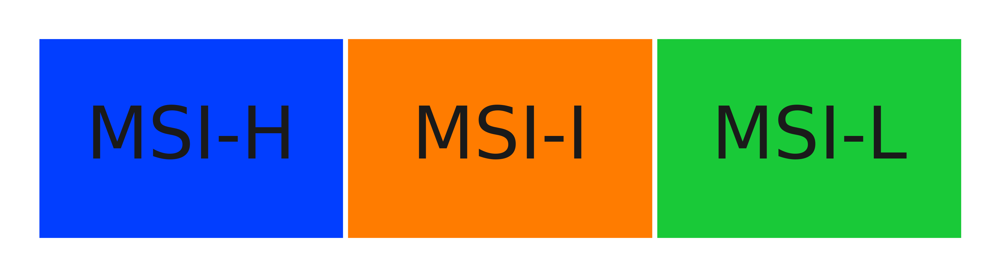

In [271]:

fig = palplot( colors, cats, size=1.0)
# plt.savefig("PBMC10k_cellType-heatmap-legend-top5.pdf", dpi=600, bbox_inches = "tight")

In [ ]:
sns.set(font_scale=1.2)
g = sns.clustermap(auc_mtx_Z[topreg], annot=False,  square=False,  linecolor='gray',
    yticklabels=False, xticklabels=True, vmin=-2, vmax=6, row_colors=colormap,
    cmap="YlGnBu", figsize=(21,16) )
g.cax.set_visible(True)
g.ax_heatmap.set_ylabel('')
g.ax_heatmap.set_xlabel('')
# plt.savefig("PBMC10k_cellType-heatmap-top5.pdf", dpi=600, bbox_inches = "tight")

In [273]:
auc_mtx_Z.to_csv('/node200data/18parkky/datasets/data/public/processed_data/Immunotherapy_CRC_Chen_et_al/3_GeneExpressionAnalysis/SCENIC/auc_mtx_Z.tsv', sep='\t')